<p style="color: #2374CA; font-size: 40px; font-weight: bold"> Predict sleep duration based on lifestyle

<p style="font-weight: bold; font-size: 30px; padding: 0px; marging: 0px;"> Module import <p>

In [99]:
from sklearn import metrics
from sklearn.metrics import roc_curve
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
import os
import zipfile
import pandas as pd
import numpy as np
import os
import seaborn as sns
import statsmodels.formula.api as smf
import statsmodels.api as sm
import scipy.stats as stats
from sklearn.preprocessing import OrdinalEncoder, LabelEncoder
from sklearn.impute import KNNImputer
from sklearn.model_selection import StratifiedShuffleSplit
from sklearn.ensemble import  RandomForestClassifier
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import f1_score, precision_score, recall_score, classification_report, roc_auc_score, confusion_matrix
from sklearn.model_selection import RandomizedSearchCV
from scipy.stats import randint
from sklearn.inspection import permutation_importance
from sklearn.linear_model import LogisticRegression
from sklearn.linear_model import Perceptron
from scipy.stats import loguniform
from sklearn.linear_model import SGDClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.svm import SVC 
from sklearn.naive_bayes import GaussianNB
from sklearn.metrics import accuracy_score, classification_report
from sklearn.model_selection import cross_val_predict
from sklearn.metrics import confusion_matrix
import time
from functools import wraps

In [100]:
# compatibility python 2 and 3
from  __future__ import division, print_function, unicode_literals

# stability of the notebook
np.random.seed(42)
RANDOM_SEED = 42

<p style="font-weight: bold; font-size: 30px; padding: 0px; marging: 0px;"> Image saving setup <p>

In [101]:
import matplotlib.pyplot as plt 

# Size of the plot
plt.rcParams['axes.labelsize'] = 14
plt.rcParams['xtick.labelsize'] = 12
plt.rcParams['ytick.labelsize'] = 12

# Where to save the plot
PROJECT_ROOT_DIR = "."
DIRECTORY_NAME = "Images"
IMAGES_PATH = os.path.join(PROJECT_ROOT_DIR, "images", DIRECTORY_NAME) # Directory must exist

def save_fig(fig_id, tight_layout=True, fig_extension="png", resolution=300):
    path = os.path.join(IMAGES_PATH, fig_id + "." + fig_extension)
    print("Saving figure", fig_id)
    if tight_layout:
        plt.tight_layout()
    plt.savefig(path, format=fig_extension, dpi=resolution)

# ignorer les warnings inutiles (voir SciPy issue #5998)
import warnings
warnings.filterwarnings(action="ignore", message="^internal gelsd")


<p style="font-weight: bold; font-size: 30px; padding: 0px; marging: 0px;"> Pipeline <p>

In [102]:
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.impute import SimpleImputer
from sklearn.feature_selection import SelectKBest, f_regression

def create_pipeline(model, model_name='model'):
    return Pipeline([
       # ('imputer', SimpleImputer(strategy='mean')),  # Handle missing values
        ('scaler', StandardScaler()),  # Standardize features
        #('feature_selection', SelectKBest(score_func=f_regression, k='all')),  # Feature selection
        (model_name, model)  # Model
    ])

<p style="font-weight: bold; font-size: 30px; padding: 0px; marging: 0px;"> Extraction and loading <p>

In [103]:
DATA_PATH = os.path.join("dataset", "data")

def fetch_data(data_path = DATA_PATH):
    if not os.path.isdir(data_path):
        os.makedirs(data_path)
    zip_path = os.path.join(data_path, "archive.zip")
    with zipfile.ZipFile(zip_path, 'r') as data_zip : 
        data_zip.extractall(path=data_path)
        data_zip.close()

fetch_data()

In [104]:
def load_data(data_file, data_path=DATA_PATH): 
    csv_path = os.path.join(data_path, data_file)
    read_data = pd.read_csv(csv_path)

    return read_data

In [105]:
general_data = load_data("extended_sleeptime_dataset.csv")

In [106]:
general_data.head(18)

,WorkoutTime,ReadingTime,PhoneTime,WorkHours,CaffeineIntake,RelaxationTime,SleepTime
0,1.316477,0.558609,3.665960,9.212321,127.022133,0.906589,10.000000
1,0.523629,1.670753,5.669353,6.629101,107.270619,0.021438,10.000000
2,0.850305,0.018392,2.553543,6.952931,152.320542,1.548675,10.000000
3,0.729934,1.202356,3.068941,8.342673,36.511333,0.703869,9.466868
4,0.562323,0.398191,3.734100,7.273657,180.722210,1.577845,10.000000
5,0.802832,0.893602,5.752205,5.096731,213.566275,0.990515,10.000000
6,1.288750,1.590687,2.791085,7.029120,275.380018,1.950437,10.000000
7,2.780912,0.558565,1.329394,6.368466,166.667749,1.555088,10.000000
8,1.297937,1.013463,0.157861,8.514628,127.785141,1.169280,10.000000
9,0.952039,0.192305,1.900469,7.591818,136.979107,0.542466,10.000000


In [107]:
general_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5000 entries, 0 to 4999
Data columns (total 7 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   WorkoutTime     5000 non-null   float64
 1   ReadingTime     5000 non-null   float64
 2   PhoneTime       5000 non-null   float64
 3   WorkHours       5000 non-null   float64
 4   CaffeineIntake  5000 non-null   float64
 5   RelaxationTime  5000 non-null   float64
 6   SleepTime       5000 non-null   float64
dtypes: float64(7)
memory usage: 273.6 KB


In [108]:
general_data.describe()

,WorkoutTime,ReadingTime,PhoneTime,WorkHours,CaffeineIntake,RelaxationTime,SleepTime
count,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000
mean,1.506117,0.989483,3.019825,7.049808,150.163228,1.012027,9.862770
std,0.865393,0.572287,1.746957,1.713855,85.619970,0.571233,0.379673
min,0.000218,0.000062,0.001995,4.004900,0.119176,0.000046,7.093400
25%,0.782530,0.493178,1.520644,5.572341,76.999790,0.515994,10.000000
50%,1.517454,0.988797,3.028116,7.105087,150.673271,1.015326,10.000000
75%,2.247829,1.477905,4.567025,8.517068,224.446074,1.503280,10.000000
max,2.999913,1.999033,5.998944,9.999267,299.912567,1.999516,10.000000


<p style="font-weight: bold; font-size: 30px; padding: 0px; marging: 0px;"> General data vizualisation <p>

array([[<Axes: title={'center': 'WorkoutTime'}>,
        <Axes: title={'center': 'ReadingTime'}>,
        <Axes: title={'center': 'PhoneTime'}>],
       [<Axes: title={'center': 'WorkHours'}>,
        <Axes: title={'center': 'CaffeineIntake'}>,
        <Axes: title={'center': 'RelaxationTime'}>],
       [<Axes: title={'center': 'SleepTime'}>, <Axes: >, <Axes: >]],
      dtype=object)

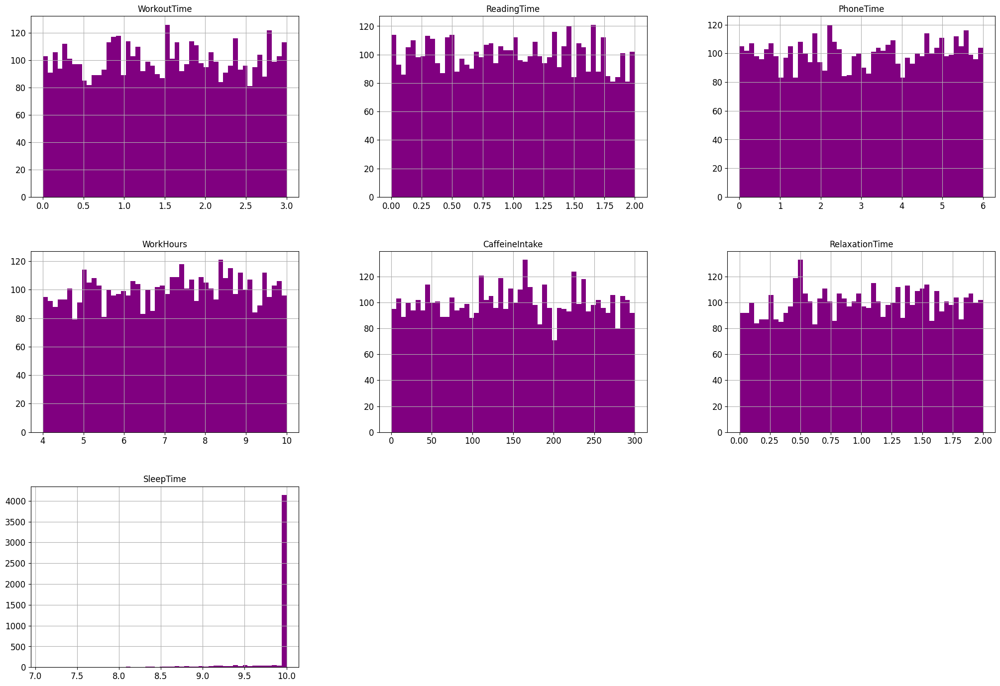

In [109]:
general_data.hist(bins=50, color= 'purple', figsize=(25, 17))

<p style="font-weight: bold; font-size: 30px; padding: 0px; marging: 0px;"> data preparation <p>

In [110]:
general_data_copy = general_data.copy()

<p style="font-weight: bold; font-size: 30px; padding: 0px; marging: 0px;"> Analysis <p>

### Correlation matrix

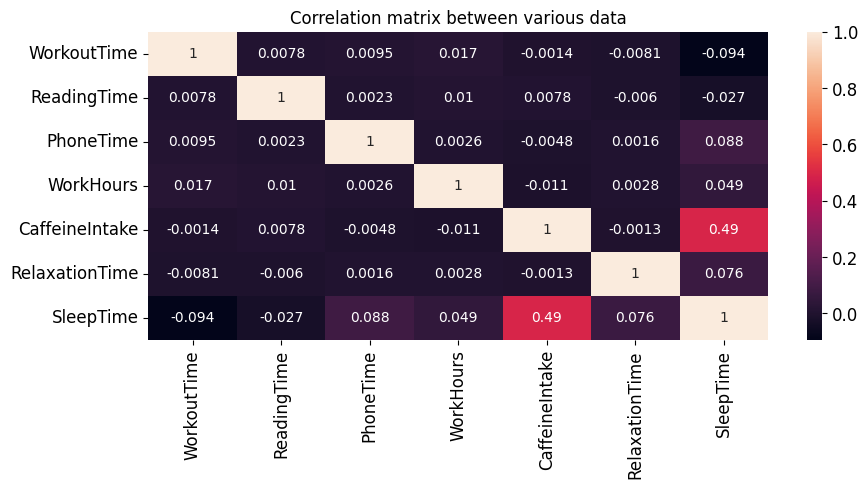

In [111]:
corr_matrix = general_data_copy.corr(method='kendall')

plt.figure(figsize=(10, 4))
sns.heatmap(corr_matrix, annot=True)

plt.title('Correlation matrix between various data')

# save_fig('Correlation_matrix')

plt.show()


<p style="font-weight: bold; font-size: 30px; padding: 0px; marging: 0px;"> SPLIT DATA <p>

In [112]:
from sklearn.model_selection import train_test_split

train_set, test_set = train_test_split(general_data_copy, test_size=0.2, random_state=42)

In [113]:
train_set.shape

(4000, 7)

In [114]:
test_set.shape

(1000, 7)

In [115]:
X_train = train_set.drop('SleepTime', axis=1)
Y_train = train_set['SleepTime'].copy()

X_test = test_set.drop('SleepTime', axis=1)
Y_test = test_set['SleepTime'].copy()

In [116]:
random_forest_regressor = RandomForestRegressor(n_estimators=50, random_state=42)
forest_regressor = create_pipeline(random_forest_regressor, 'random_forest')
forest_regressor.fit(X_train, Y_train)

Pipeline(steps=[('scaler', StandardScaler()),
                ('random_forest',
                 RandomForestRegressor(n_estimators=50, random_state=42))])

In [117]:
prediction = forest_regressor.predict(X_test)

prediction

array([ 9.82699992, 10.        , 10.        ,  8.93587007,  9.6773007 ,
       10.        , 10.        , 10.        , 10.        ,  9.67159886,
        9.98225003, 10.        , 10.        , 10.        , 10.        ,
        9.98157678,  9.61086049, 10.        ,  9.93961619, 10.        ,
        9.86756587,  9.99969187, 10.        ,  9.55605317,  8.73663886,
       10.        , 10.        , 10.        ,  9.64951695, 10.        ,
       10.        ,  9.62116407, 10.        , 10.        ,  8.94102078,
       10.        , 10.        , 10.        , 10.        , 10.        ,
        9.93461621,  9.97766281, 10.        ,  9.78308538,  9.92911359,
       10.        , 10.        , 10.        , 10.        ,  9.95618907,
        9.82567535, 10.        , 10.        , 10.        ,  9.19680483,
       10.        , 10.        , 10.        , 10.        ,  9.98527666,
        9.99304669,  8.91813003,  9.88140997, 10.        ,  9.53444343,
       10.        , 10.        , 10.        , 10.        , 10.  

In [118]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

mse = mean_squared_error(Y_test, prediction)
mae = mean_absolute_error(Y_test, prediction)
r2 = r2_score(Y_test, prediction)

print('=========================Algorithm evaluation: regression report on test data==================================')
print('Mean Squared Error:', mse)
print('Mean Absolute Error:', mae)
print('R^2 Score:', r2)

# Save predictions to a CSV file
predictions = pd.DataFrame(prediction, columns=['Prediction'])
predictions['Id'] = X_test.index  # This adds the index as a column in our predictions DataFrame

# Now you can save this DataFrame to a CSV file
predictions.to_csv("./predictions/forest_regressor_preds.csv", index=False)

=========================Algorithm evaluation: regression report on test data==================================
Mean Squared Error: 0.05480136864608114
Mean Absolute Error: 0.09679525434752914
R^2 Score: 0.6055228703121601


In [ ]:
# Let's define the parameters for their random search
param_dist = {
    'random_forest__n_estimators': randint(50, 800), # Number of trees in the forest
    'random_forest__max_depth': randint(5, 30),    # Maximum depth of each tree
    'random_forest__min_samples_split': randint(2, 10), # Minimum number of samples required to split an internal node
    'random_forest__min_samples_leaf': randint(1, 4),  # Minimum number of samples required at a leaf node
    'random_forest__bootstrap': [True, False],   # Method for sampling data points (with or without replacement)
    'random_forest__criterion': ['squared_error', 'absolute_error', 'friedman_mse', 'poisson'], # The function to measure the quality of a split
}

random_search = RandomizedSearchCV(
    estimator=forest_regressor,
    param_distributions=param_dist,
    n_iter=50,  # Number of parameter settings sampled. Based on our computational resources.
    cv=5,       # Number of folds in cross-validation
    verbose=1,  # Controls the verbosity: the higher, the more messages.
    n_jobs=-1,  # Number of jobs to run in parallel
    random_state=42,  # Ensures reproducibility
)

random_search.fit(X_train, Y_train)

Fitting 5 folds for each of 50 candidates, totalling 250 fits


In [ ]:
print('The best parameters are :', random_search.best_params_)
print("Best score is:", random_search.best_score_)

The best parameters are : {'random_forest__bootstrap': True, 'random_forest__criterion': 'poisson', 'random_forest__max_depth': 17, 'random_forest__min_samples_leaf': 3, 'random_forest__min_samples_split': 4, 'random_forest__n_estimators': 292}
Best score is: 0.7058880450007857


In [ ]:
random_forest_classifier_hyperparams = RandomForestRegressor(
    n_estimators=395, min_samples_split=3, min_samples_leaf=2, max_depth=24, criterion='squared_error', 
    bootstrap=False, random_state=42)

forest_regressor_hyperparams = create_pipeline(random_forest_classifier_hyperparams, 'random_forest_classifier_hyperparams')

forest_regressor_hyperparams.fit(X_train, Y_train)

Pipeline(steps=[('scaler', StandardScaler()),
                ('random_forest_classifier_hyperparams',
                 RandomForestRegressor(bootstrap=False, max_depth=24,
                                       min_samples_leaf=2, min_samples_split=3,
                                       n_estimators=395, random_state=42))])

In [ ]:
prediction_hyperparams = forest_regressor_hyperparams.predict(X_test)
prediction_hyperparams

array([ 9.7431342 , 10.        , 10.        ,  8.74564032,  9.62475585,
       10.        , 10.        , 10.        , 10.        ,  8.93389215,
       10.        , 10.        , 10.        , 10.        , 10.        ,
       10.        ,  9.17015313, 10.        , 10.        , 10.        ,
       10.        , 10.        , 10.        ,  9.90090163,  8.48733808,
       10.        , 10.        , 10.        ,  9.64762374, 10.        ,
       10.        ,  9.52378775, 10.        , 10.        ,  8.80245895,
       10.        , 10.        , 10.        , 10.        , 10.        ,
       10.        , 10.        , 10.        , 10.        , 10.        ,
       10.        , 10.        , 10.        , 10.        , 10.        ,
        9.85909309, 10.        , 10.        , 10.        ,  8.83875263,
       10.        , 10.        , 10.        ,  9.56353073, 10.        ,
        9.99196224,  8.41054461, 10.        , 10.        ,  9.98830043,
       10.        , 10.        , 10.        , 10.        , 10.  

In [ ]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

mse_hyperparams = mean_squared_error(Y_test, prediction_hyperparams)
mae_hyperparams = mean_absolute_error(Y_test, prediction_hyperparams)
r2_hyperparams = r2_score(Y_test, prediction_hyperparams)

print('=========================Algorithm evaluation: regression report on test data==================================')
print('Mean Squared Error:', mse_hyperparams)
print('Mean Absolute Error:', mae_hyperparams)
print('R^2 Score:', r2_hyperparams)

# Save predictions to a CSV file
predictions_hyperparams = pd.DataFrame(prediction_hyperparams, columns=['Prediction'])
predictions_hyperparams['Id'] = X_test.index  # This adds the index as a column in our predictions DataFrame

# Now you can save this DataFrame to a CSV file
predictions_hyperparams.to_csv("./predictions/forest_regressor_preds_hyperparams.csv", index=False)

=========================Algorithm evaluation: regression report on test data==================================
Mean Squared Error: 0.08867818300214006
Mean Absolute Error: 0.11318976219936415
R^2 Score: 0.36166712691912417


### Logistic regression

In [ ]:
from sklearn.linear_model import SGDRegressor

sgd_regressor = SGDRegressor(random_state=42, max_iter=1000)

sgd_pipeline = create_pipeline(sgd_regressor, 'sgd_regressor')

sgd_pipeline.fit(X_train, Y_train)

Pipeline(steps=[('scaler', StandardScaler()),
                ('sgd_regressor', SGDRegressor(random_state=42))])

In [ ]:
SGD_predict = sgd_pipeline.predict(X_test)

SGD_predict

array([ 9.63477287,  9.94802584, 10.13344717,  9.50539075,  9.61223348,
        9.80210891,  9.82975591,  9.96178622,  9.88433726,  9.66494961,
        9.76946343,  9.78458897, 10.15102201,  9.88717655,  9.87819487,
        9.65265929,  9.69473951,  9.93004104,  9.68442251, 10.2810515 ,
        9.61307315,  9.87275822,  9.90641604,  9.56187902,  9.46077321,
        9.84400878,  9.97144148,  9.97184979,  9.66034274, 10.08815577,
        9.88475368,  9.63475809, 10.00069366, 10.01021186,  9.51991081,
       10.26054694,  9.93613999,  9.88531605, 10.11382834,  9.81097112,
        9.78857499,  9.76589899,  9.79122449,  9.69548275,  9.71185044,
       10.08945066,  9.80505541,  9.93752718,  9.78857954,  9.71804026,
        9.68251984, 10.05609032,  9.99820531,  9.77886275,  9.55578608,
        9.89549676, 10.01858113, 10.13390593,  9.76581976,  9.76716431,
        9.75385354,  9.46102981,  9.68394146, 10.008482  ,  9.50016572,
        9.75277907,  9.99791182,  9.92050391, 10.03073353,  9.83

In [ ]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

mse_sgd = mean_squared_error(Y_test, SGD_predict)
mae_sgd = mean_absolute_error(Y_test, SGD_predict)
r2_sgd = r2_score(Y_test, SGD_predict)

print("Mean Squared Error:", mse_sgd)
print("Mean Absolute Error:", mae_sgd)
print("R^2 Score:", r2_sgd)

# Create a DataFrame for predictions and save to CSV
predictions_df = pd.DataFrame(SGD_predict, columns=['Prediction'])
predictions_df['Id'] = X_test.index  # This adds the index as a column in our predictions DataFrame

predictions_df.to_csv("./predictions/sgd_pred.csv", index=False)

Mean Squared Error: 0.09443914846375798
Mean Absolute Error: 0.2075133807852377
R^2 Score: 0.32019792321717744


In [ ]:
from scipy.stats import uniform
from sklearn.linear_model import SGDRegressor

sgd = SGDRegressor(random_state=42)

param_dist = {
    'sgd__alpha': uniform(0.0001, 0.1),
    'sgd__penalty': ['l1', 'l2', 'elasticnet']
}

sgd_pipeline = create_pipeline(sgd, 'sgd')

sgd_random_search = RandomizedSearchCV(sgd_pipeline, param_distributions=param_dist, n_iter=50, cv=5, random_state=42, error_score='raise')
sgd_random_search.fit(X_train, Y_train)

RandomizedSearchCV(cv=5, error_score='raise',
                   estimator=Pipeline(steps=[('scaler', StandardScaler()),
                                             ('sgd',
                                              SGDRegressor(random_state=42))]),
                   n_iter=50,
                   param_distributions={'sgd__alpha': <scipy.stats._distn_infrastructure.rv_continuous_frozen object at 0x00000237CCA90C20>,
                                        'sgd__penalty': ['l1', 'l2',
                                                         'elasticnet']},
                   random_state=42)

In [ ]:
print("The best parameters are: ", sgd_random_search.best_params_)
print("The best score: ", sgd_random_search.best_score_)

The best parameters are:  {'sgd__alpha': np.float64(0.0032313292455558584), 'sgd__penalty': 'l2'}
The best score:  0.3163682192244834


In [ ]:
sgd_hparams = SGDClassifier(alpha=0.0021584494295802444, loss='log_loss', penalty='l2')
sgd_hparams = create_pipeline(sgd, 'SGDClassifier')

sgd_hparams.fit(X_train, Y_train)

Pipeline(steps=[('scaler', StandardScaler()),
                ('SGDClassifier', SGDRegressor(random_state=42))])

In [ ]:
sgd_hparams_pred = sgd_hparams.predict(X_test)
sgd_hparams_pred

array([ 9.63477287,  9.94802584, 10.13344717,  9.50539075,  9.61223348,
        9.80210891,  9.82975591,  9.96178622,  9.88433726,  9.66494961,
        9.76946343,  9.78458897, 10.15102201,  9.88717655,  9.87819487,
        9.65265929,  9.69473951,  9.93004104,  9.68442251, 10.2810515 ,
        9.61307315,  9.87275822,  9.90641604,  9.56187902,  9.46077321,
        9.84400878,  9.97144148,  9.97184979,  9.66034274, 10.08815577,
        9.88475368,  9.63475809, 10.00069366, 10.01021186,  9.51991081,
       10.26054694,  9.93613999,  9.88531605, 10.11382834,  9.81097112,
        9.78857499,  9.76589899,  9.79122449,  9.69548275,  9.71185044,
       10.08945066,  9.80505541,  9.93752718,  9.78857954,  9.71804026,
        9.68251984, 10.05609032,  9.99820531,  9.77886275,  9.55578608,
        9.89549676, 10.01858113, 10.13390593,  9.76581976,  9.76716431,
        9.75385354,  9.46102981,  9.68394146, 10.008482  ,  9.50016572,
        9.75277907,  9.99791182,  9.92050391, 10.03073353,  9.83

In [ ]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

mse_sgd_hparams = mean_squared_error(Y_test, sgd_hparams_pred)
mae_sgd_hparams = mean_absolute_error(Y_test, sgd_hparams_pred)
r2_sgd_hparams = r2_score(Y_test, sgd_hparams_pred)

print("Mean Squared Error:", mse_sgd_hparams)
print("Mean Absolute Error:", mae_sgd_hparams)
print("R^2 Score:", r2_sgd_hparams)

# Create a DataFrame for predictions and save to CSV
predictions_df = pd.DataFrame(sgd_hparams_pred, columns=['Prediction'])
predictions_df['Id'] = X_test.index  # This adds the index as a column in our predictions DataFrame

predictions_df.to_csv("./predictions/sgd_hparams_pred.csv", index=False)

Mean Squared Error: 0.09443914846375798
Mean Absolute Error: 0.2075133807852377
R^2 Score: 0.32019792321717744


### Decision tree

In [ ]:
from sklearn.tree import DecisionTreeRegressor

decTree = DecisionTreeRegressor(criterion='squared_error', splitter='best', max_depth=None, min_samples_split=2, min_samples_leaf=1, random_state=RANDOM_SEED)

tree = create_pipeline(decTree, 'decision_tree')

tree.fit(X_train, Y_train)

Pipeline(steps=[('scaler', StandardScaler()),
                ('decision_tree', DecisionTreeRegressor(random_state=42))])

In [ ]:
tree_pred = tree.predict(X_test)

tree_pred

array([ 9.78875754, 10.        , 10.        ,  8.69768399,  9.91176188,
       10.        , 10.        , 10.        , 10.        ,  8.95568421,
       10.        , 10.        , 10.        , 10.        , 10.        ,
       10.        ,  9.94195956, 10.        , 10.        , 10.        ,
       10.        , 10.        , 10.        , 10.        ,  8.51448693,
       10.        , 10.        , 10.        ,  9.44916894, 10.        ,
       10.        ,  9.65644547, 10.        , 10.        ,  9.74562031,
       10.        , 10.        , 10.        , 10.        , 10.        ,
       10.        , 10.        , 10.        , 10.        , 10.        ,
       10.        , 10.        , 10.        , 10.        , 10.        ,
        9.72551113, 10.        , 10.        , 10.        ,  9.15904041,
       10.        , 10.        , 10.        , 10.        , 10.        ,
        9.98448697,  8.19362842, 10.        , 10.        , 10.        ,
       10.        , 10.        , 10.        , 10.        , 10.  

In [ ]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

# Calculate regression metrics
mse_tree = mean_squared_error(Y_test, tree_pred)
mae_tree = mean_absolute_error(Y_test, tree_pred)
r2_tree = r2_score(Y_test, tree_pred)

print('=========================Algorithm evaluation: regression report on test data==================================')
print('Mean Squared Error:', mse_tree)
print('Mean Absolute Error:', mae_tree)
print('R^2 Score:', r2_tree)

# Save predictions to a CSV file
predictions_df = pd.DataFrame(tree_pred, columns=['Prediction'])
predictions_df['Id'] = X_test.index  # This adds the index as a column in our predictions DataFrame

predictions_df.to_csv("./predictions/tree_pred.csv", index=False)

=========================Algorithm evaluation: regression report on test data==================================
Mean Squared Error: 0.09821778951297509
Mean Absolute Error: 0.11989618062980219
R^2 Score: 0.2929981011681635


In [ ]:
from sklearn.model_selection import GridSearchCV

tree_param_grid = [
    {'decision_tree__criterion':["squared_error", "absolute_error", "friedman_mse", "poisson"],
        'decision_tree__splitter': ["best","random"],
        'decision_tree__min_samples_leaf':list(range(1,50)), 
        'decision_tree__min_samples_split': [2,3,4]}
  ]


tree_grid_search = GridSearchCV(tree, tree_param_grid, cv=5,
                           scoring='accuracy', return_train_score=True)
tree_grid_search.fit(X_train, Y_train)

c:\Users\Schab\AppData\Local\Programs\Python\Python313\Lib\site-packages\sklearn\model_selection\_validation.py:960: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "c:\Users\Schab\AppData\Local\Programs\Python\Python313\Lib\site-packages\sklearn\model_selection\_validation.py", line 949, in _score
    scores = scorer(estimator, X_test, y_test, **score_params)
  File "c:\Users\Schab\AppData\Local\Programs\Python\Python313\Lib\site-packages\sklearn\metrics\_scorer.py", line 288, in __call__
    return self._score(partial(_cached_call, None), estimator, X, y_true, **_kwargs)
           ~~~~~~~~~~~^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "c:\Users\Schab\AppData\Local\Programs\Python\Python313\Lib\site-packages\sklearn\metrics\_scorer.py", line 388, in _score
    return self._sign * self._score_func(y_true, y_pred, **scoring_kwargs)
                 

GridSearchCV(cv=5,
             estimator=Pipeline(steps=[('scaler', StandardScaler()),
                                       ('decision_tree',
                                        DecisionTreeRegressor(random_state=42))]),
             param_grid=[{'decision_tree__criterion': ['squared_error',
                                                       'absolute_error',
                                                       'friedman_mse',
                                                       'poisson'],
                          'decision_tree__min_samples_leaf': [1, 2, 3, 4, 5, 6,
                                                              7, 8, 9, 10, 11,
                                                              12, 13, 14, 15,
                                                              16, 17, 18, 19,
                                                              20, 21, 22, 23,
                                                              24, 25, 26, 27,
                                                              28, 29, 30, ...],
                          'decision_tree__min_samples_split': [2, 3, 4],
                          'decision_tree__splitter': ['best', 'random']}],
             return_train_score=True, scoring='accuracy')

In [ ]:
print("The best parameters are : ", tree_grid_search.best_params_)
print('Best score is:',tree_grid_search.best_score_)  # Best cross-validation score met

The best parameters are :  {'decision_tree__criterion': 'squared_error', 'decision_tree__min_samples_leaf': 1, 'decision_tree__min_samples_split': 2, 'decision_tree__splitter': 'best'}
Best score is: nan


In [ ]:
decTree_hparams = DecisionTreeClassifier(criterion='entropy', splitter='random', max_depth=None, min_samples_split=2, min_samples_leaf=1,random_state = RANDOM_SEED)

tree_hparams = create_pipeline(decTree, 'decision_tree')

tree_hparams.fit(X_train, Y_train)

Pipeline(steps=[('scaler', StandardScaler()),
                ('decision_tree', DecisionTreeRegressor(random_state=42))])

In [ ]:
tree_hparams_pred = tree_hparams.predict(X_test)
tree_hparams_pred

array([ 9.78875754, 10.        , 10.        ,  8.69768399,  9.91176188,
       10.        , 10.        , 10.        , 10.        ,  8.95568421,
       10.        , 10.        , 10.        , 10.        , 10.        ,
       10.        ,  9.94195956, 10.        , 10.        , 10.        ,
       10.        , 10.        , 10.        , 10.        ,  8.51448693,
       10.        , 10.        , 10.        ,  9.44916894, 10.        ,
       10.        ,  9.65644547, 10.        , 10.        ,  9.74562031,
       10.        , 10.        , 10.        , 10.        , 10.        ,
       10.        , 10.        , 10.        , 10.        , 10.        ,
       10.        , 10.        , 10.        , 10.        , 10.        ,
        9.72551113, 10.        , 10.        , 10.        ,  9.15904041,
       10.        , 10.        , 10.        , 10.        , 10.        ,
        9.98448697,  8.19362842, 10.        , 10.        , 10.        ,
       10.        , 10.        , 10.        , 10.        , 10.  

In [ ]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

mse_tree_hparams = mean_squared_error(Y_test, tree_hparams_pred)
mae_tree_hparams = mean_absolute_error(Y_test, tree_hparams_pred)
r2_tree_hparams = r2_score(Y_test, tree_hparams_pred)

print('=========================Algorithm evaluation: regression report on test data==================================')
print('Mean Squared Error:', mse_tree_hparams)
print('Mean Absolute Error:', mae_tree_hparams)
print('R^2 Score:', r2_tree_hparams)

# Create a DataFrame for predictions and save to CSV
predictions_df = pd.DataFrame(tree_hparams_pred, columns=['Prediction'])
predictions_df['Id'] = X_test.index  # This adds the index as a column in our predictions DataFrame

predictions_df.to_csv("./predictions/tree_hparams_pred.csv", index=False)

=========================Algorithm evaluation: regression report on test data==================================
Mean Squared Error: 0.09821778951297509
Mean Absolute Error: 0.11989618062980219
R^2 Score: 0.2929981011681635


### Confusion Matrix

In [ ]:
from sklearn.linear_model import LinearRegression

#La matrice de confusion est l'outil incontournable lorsqu'il s'agit d'étudier les performances d'un système de classification supervisé.
def display_confusion_matrix(pred, name):
    # Binning the continuous predictions into discrete classes
    bins = np.linspace(Y_train.min(), Y_train.max(), 10)
    pred_binned = np.digitize(pred, bins)
    y_train_binned = np.digitize(Y_train, bins)
    
    matrix = confusion_matrix(y_train_binned, pred_binned)

    print("----------------------")
    print("Name:", name)
    print(matrix)

# Define linear regression with hyperparameters
lin_reg_hyperparameters = LinearRegression()
rl_prediction = cross_val_predict(lin_reg_hyperparameters, X_train, Y_train, cv=10)
display_confusion_matrix(rl_prediction, 'Linear Regression')

dt_prediction = cross_val_predict(tree_hparams, X_train, Y_train, cv=10)
display_confusion_matrix(dt_prediction, 'Decision Tree')

rf_prediction = cross_val_predict(random_forest_classifier_hyperparams, X_train, Y_train, cv=10)
display_confusion_matrix(rf_prediction, 'Random Forest')

sgd_prediction = cross_val_predict(sgd_hparams, X_train,Y_train, cv=10)
display_confusion_matrix(sgd_prediction, 'SGDRegressor')


----------------------
Name: Linear Regression
[[   0    0    0    0    0    0    2    2    0    0]
 [   0    0    0    0    0    0    1   11    0    0]
 [   0    0    0    0    0    0    1    8    0    0]
 [   0    0    0    0    0    0    0   38    0    0]
 [   0    0    0    0    0    0    0   69    1    0]
 [   0    0    0    0    0    0    0   91    1    0]
 [   0    0    0    0    0    0    0  126    6    0]
 [   0    0    0    0    0    0    0  157   17    0]
 [   0    0    0    0    0    0    0  149   41    0]
 [   0    0    0    0    0    0    0  263 1842 1174]]
----------------------
Name: Decision Tree
[[   1    0    0    1    1    1    0    0    0    0]
 [   2    2    0    1    3    4    0    0    0    0]
 [   0    0    1    2    4    0    2    0    0    0]
 [   2    3    1    7    5    9    5    4    2    0]
 [   1    3    3    4    5   12   13   13    9    7]
 [   0    2    0    5   15   15   21   13   11   10]
 [   0    1    0   12    6   21   22   28   20   22]
 [   0  

## Courbe ROC

c:\Users\Schab\AppData\Local\Programs\Python\Python313\Lib\site-packages\sklearn\metrics\_ranking.py:1180: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  warnings.warn(


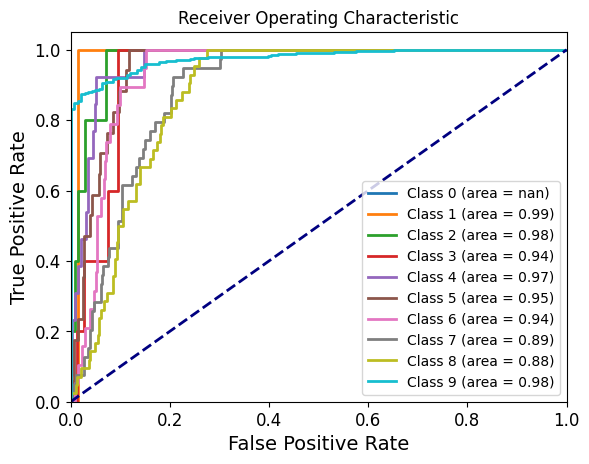

In [ ]:
import matplotlib.pyplot as plt
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import roc_curve, auc
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import KBinsDiscretizer, label_binarize
from sklearn.multiclass import OneVsRestClassifier

# Séparer les caractéristiques et la cible
X = general_data_copy.drop('SleepTime', axis=1)
y = general_data_copy['SleepTime']

# Binning the continuous target variable into discrete classes
kbins = KBinsDiscretizer(n_bins=10, encode='ordinal', strategy='uniform')
y_binned = kbins.fit_transform(y.values.reshape(-1, 1)).astype(int).ravel()

# Diviser les données en ensembles d'entraînement et de test
X_train, X_test, y_train, y_test = train_test_split(X, y_binned, test_size=0.2, random_state=42)

# Binarize the output labels for one-vs-rest classification
y_train_bin = label_binarize(y_train, classes=np.arange(10))
y_test_bin = label_binarize(y_test, classes=np.arange(10))

# Créer et ajuster le modèle de régression logistique
logistic_regression_model = OneVsRestClassifier(LogisticRegression(max_iter=1000))
logistic_regression_model.fit(X_train, y_train_bin)

# Prédire les probabilités des classes
y_prob = logistic_regression_model.predict_proba(X_test)

# Calculer la courbe ROC et l'AUC pour chaque classe
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(10):
	fpr[i], tpr[i], _ = roc_curve(y_test_bin[:, i], y_prob[:, i])
	roc_auc[i] = auc(fpr[i], tpr[i])

# Tracer la courbe ROC pour chaque classe
plt.figure()
for i in range(10):
	plt.plot(fpr[i], tpr[i], lw=2, label='Class %d (area = %0.2f)' % (i, roc_auc[i]))

plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic')
plt.legend(loc="lower right")
plt.show()

Mean Squared Error: 0.0939
R² Score: 0.3240

Top 5 des variables les plus influentes sur le sommeil :
         Variable  Coefficient
5  RelaxationTime     0.071022
0     WorkoutTime    -0.062126
2       PhoneTime     0.027436
1     ReadingTime    -0.027058
3       WorkHours     0.014903

Impact de la caféine sur le sommeil : 0.0023
💡 La caféine semble augmenter le sommeil (effet inhabituel).


C:\Users\Schab\AppData\Local\Temp\ipykernel_17364\3095100077.py:59: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Coefficient', y='Variable', data=coefficients, palette='coolwarm')


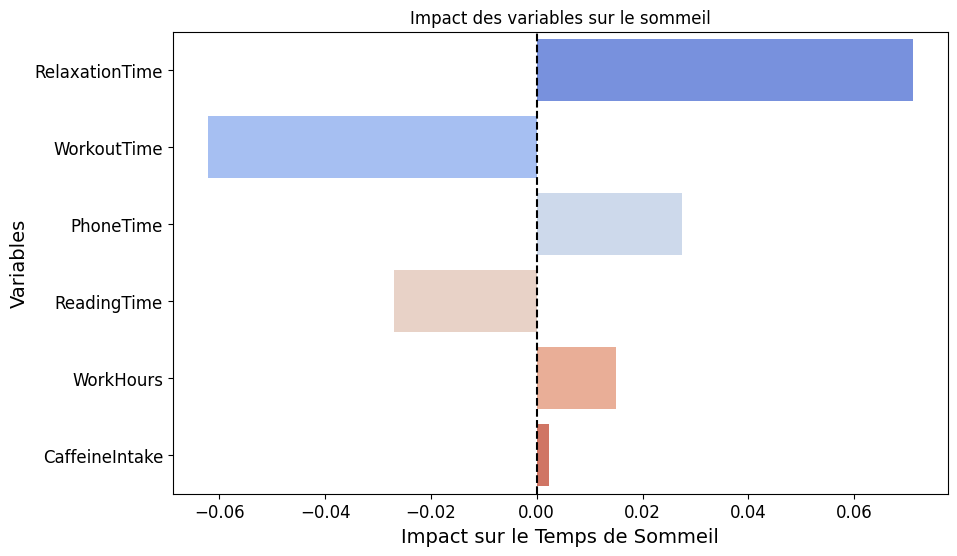

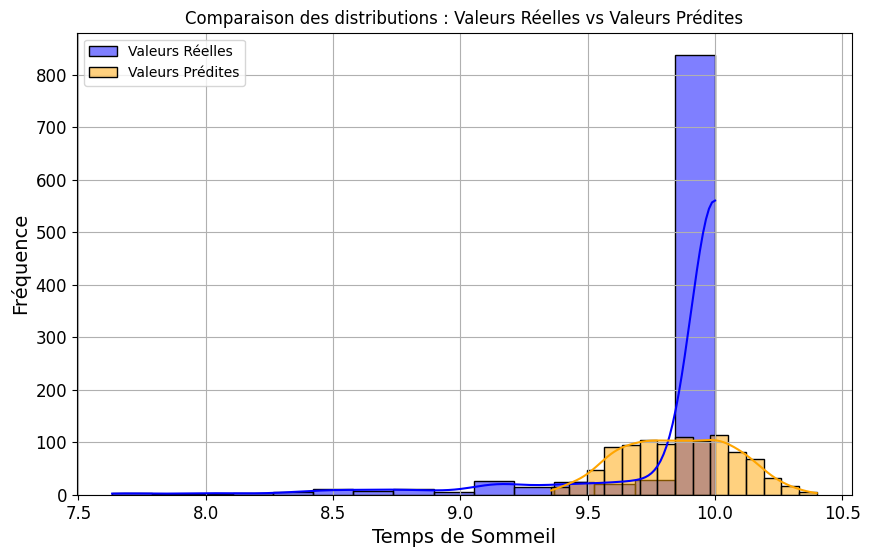

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import numpy as np
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.model_selection import train_test_split

# Vérifier que la colonne CaffeineIntake existe
if 'CaffeineIntake' not in general_data_copy.columns:
    raise ValueError("La colonne 'CaffeineIntake' est absente des données !")

# Séparer les caractéristiques et la cible
X = general_data_copy.drop('SleepTime', axis=1)
y = general_data_copy['SleepTime']

# Diviser les données en ensembles d'entraînement et de test
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Créer et ajuster le modèle de régression linéaire
linear_regression_model = LinearRegression()
linear_regression_model.fit(X_train, y_train)

# Prédire les valeurs
y_pred = linear_regression_model.predict(X_test)

# Calculer les métriques de régression
mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print(f'Mean Squared Error: {mse:.4f}')
print(f'R² Score: {r2:.4f}')

# Analyser l'impact des variables
coefficients = pd.DataFrame({
    'Variable': X.columns,
    'Coefficient': linear_regression_model.coef_
})

# Trier les variables par importance (valeur absolue du coefficient)
coefficients['Abs_Coefficient'] = coefficients['Coefficient'].abs()
coefficients = coefficients.sort_values(by='Abs_Coefficient', ascending=False)

# Afficher les 5 variables les plus influentes
print("\nTop 5 des variables les plus influentes sur le sommeil :")
print(coefficients.head(5)[['Variable', 'Coefficient']])

# Vérifier l'impact de la caféine
caffeine_impact = coefficients[coefficients['Variable'] == 'CaffeineIntake']
if not caffeine_impact.empty:
    print(f"\nImpact de la caféine sur le sommeil : {caffeine_impact.iloc[0]['Coefficient']:.4f}")
    if caffeine_impact.iloc[0]['Coefficient'] > 0:
        print("💡 La caféine semble augmenter le sommeil (effet inhabituel).")
    else:
        print("⚠️ La caféine ne semble pas réduire le sommeil, ce qui est logique.")

# Visualisation des coefficients sous forme de barres
plt.figure(figsize=(10, 6))
sns.barplot(x='Coefficient', y='Variable', data=coefficients, palette='coolwarm')
plt.axvline(0, color='black', linestyle='--')
plt.xlabel('Impact sur le Temps de Sommeil')
plt.ylabel('Variables')
plt.title('Impact des variables sur le sommeil')
plt.show()

# Création de l'histogramme amélioré des valeurs réelles vs prédites
plt.figure(figsize=(10, 6))
sns.histplot(y_test, bins=15, kde=True, color='blue', label='Valeurs Réelles', alpha=0.5)
sns.histplot(y_pred, bins=15, kde=True, color='orange', label='Valeurs Prédites', alpha=0.5)
plt.xlabel('Temps de Sommeil')
plt.ylabel('Fréquence')
plt.title('Comparaison des distributions : Valeurs Réelles vs Valeurs Prédites')
plt.legend()
plt.grid(True)
plt.show()


Mean Squared Error: 0.09390453419662267
R^2 Score: 0.3240462413668881


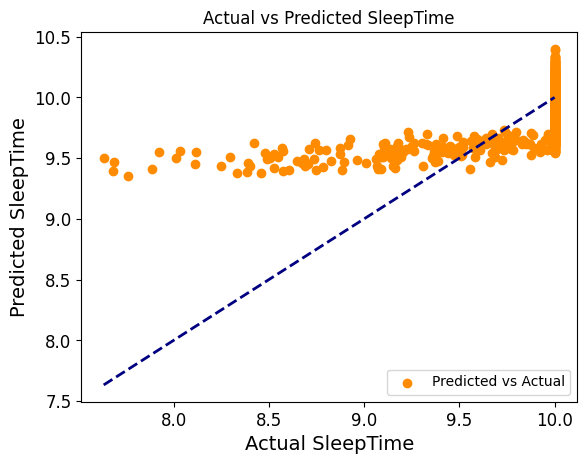

In [ ]:
import matplotlib.pyplot as plt
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.model_selection import train_test_split

# Séparer les caractéristiques et la cible
X = general_data_copy.drop('SleepTime', axis=1)
y = general_data_copy['SleepTime']

# Diviser les données en ensembles d'entraînement et de test
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Créer et ajuster le modèle de régression linéaire
linear_regression_model = LinearRegression()
linear_regression_model.fit(X_train, y_train)

# Prédire les valeurs
y_pred = linear_regression_model.predict(X_test)

# Calculer les métriques de régression
mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print('Mean Squared Error:', mse)
print('R^2 Score:', r2)

# Tracer les valeurs prédites vs les valeurs réelles
plt.figure()
plt.scatter(y_test, y_pred, color='darkorange', label='Predicted vs Actual')
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], color='navy', lw=2, linestyle='--')
plt.xlabel('Actual SleepTime')
plt.ylabel('Predicted SleepTime')
plt.title('Actual vs Predicted SleepTime')
plt.legend(loc="lower right")
plt.show()